In [22]:
%matplotlib inline
import matplotlib.patches as patches
from matplotlib import pyplot as plt

In [2]:
import torch
import torch.nn as nn
from torchsummary import summary
from os.path import join
from tqdm import tqdm
import glob
import numpy as np
import os
import cv2
import heapq
from pandas import DataFrame

from modules.custom import Generator3, Generator4
from config import Config,MyConfig
from init_utils import get_yolo
from ops import detect_nob, prep_frame
import data_utils
import calc_scores
import crop_utils
import init_utils

/home/chojh21c/anaconda3/envs/dvaa/lib/python3.8/site-packages/scipy/__init__.py:138: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5)
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion} is required for this version of "


In [3]:
cfg = MyConfig()

for key in cfg.__dict__:
    print(key,':',cfg.__dict__[key])

gen_name = cfg.generator
fn_name = cfg.flownet
resume = cfg.resume
optimizer_name = cfg.optimizer
scheduler_name = cfg.scheduler
in_channels = 3
out_channels = 3
cfg.confidence = 0.6

tr_name : shanghai_cropped_08
te_name : shanghaitech
device : cuda
cwd : /home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection
ad_home : /home/chojh21c/sunghyun/Anomaly_Detection
data_home : /home/chojh21c/sunghyun/Anomaly_Detection/m8/datasets
save_name : checkpoints
nframe : 4
resize_h : 64
resize_w : 64
max_h : 480
max_w : 856
symmetric : False
factor_x : 1.5
factor_y : 1.2
confidence : 0.4
gamma : 0.3
generator : custom4
n_kernels : [32, 64, 64, 128]
bn_kernel : 128
flownet : lite
att_dim : 256
resume : None
batch_size : 32
epoch : 10
save_epoch : 5
verbose : 10
g_lr : 0.001
d_lr : 0.0001
l2 : 1e-05
init : kaiming
optimizer : adamw
scheduler : cosine
warm_cycle : 10000
lambdas : [1.0, 1.0, 1.0, 2.0]
show_curve : True
trained_model : None


이미지 출력 함수

In [4]:
# imshow function (cv2 image -> plt image -> plt.show)
# cv2 image를 plt image로 출력 
def imshow(in_img):
    out_img = cv2.cvtColor(in_img,cv2.COLOR_BGR2RGB) 
    plt.figure(figsize=(7,7))
    plt.imshow(out_img)
    plt.axis('off')
    plt.show()

# tensor image -> plt show
def timshow(img):
    img=img.permute(1,2,0)
    plt.figure(figsize=(3,3))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

데이터 경로

In [5]:
# ped2
path='/home/chojh21c/sunghyun/DATASET/ano_simul'
detail='UCSD Ped2/02/frames'
_detail='UCSD Ped2_02'
cfg.gamma = 0.05
name = 'ped2'
an_idx = 1 # ('02'=1, '04'=3)

In [5]:
# avenue
path='/home/chojh21c/sunghyun/DATASET/ano_simul'
detail='Avenue/07/frames'
_detail='Avenue_02'
cfg.gamma = 0.3
name = 'avenue'
an_idx = 1 # ('02'=1, '07'=6)

In [7]:
# shanghai
path='/home/chojh21c/sunghyun/DATASET/ano_simul'
detail='Shanghai Tech/01_0130/frames'
_detail='Shanghai Tech_01_0130'
cfg.gamma = 0.3
name = 'shanghai'
an_idx = 20 # ('01_0129'=19, '01_0130'=20)

시뮬레이션 데이터 확인

/home/chojh21c/sunghyun/DATASET/ano_simul/UCSD Ped2/02/frames/017.jpg


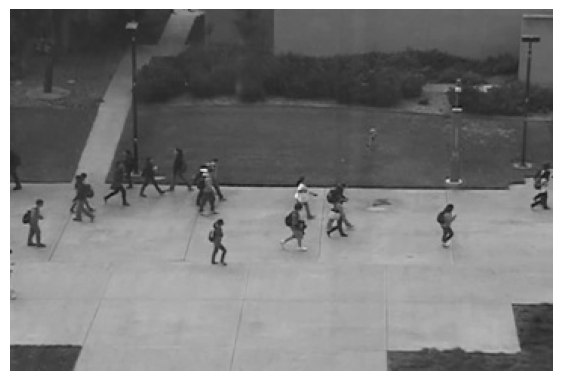

In [6]:
import random

dir=os.path.join(path,detail)
pathlist=os.listdir(dir)
r=random.randint(0,len(pathlist))

rpath=dir+'/'+pathlist[r]
print(rpath)

img=cv2.imread(rpath)
imshow(img)

모델 (생성기)

In [7]:
# ped2
cfg.att_dim = 256
generator = Generator4(in_channels, out_channels, cfg=cfg).eval()
generator.to('cuda')
ckpt = torch.load('weight/Best/ped2/total_model_e14.pt')
generator.load_state_dict(ckpt['net_g'])

<All keys matched successfully>

In [7]:
# avenue
cfg.att_dim = 512
generator = Generator4(in_channels, out_channels, cfg=cfg).eval()
generator.to('cuda')
ckpt = torch.load('weight/Best/avenue/total_model_e10.pt')
generator.load_state_dict(ckpt['net_g'])

<All keys matched successfully>

In [10]:
# shanghaitech
cfg.att_dim = 512
generator = Generator4(in_channels, out_channels, cfg=cfg).eval()
generator.to('cuda')
ckpt = torch.load('weight/Best/shanghai/total_model_e46.pt')
generator.load_state_dict(ckpt['net_g'])

<All keys matched successfully>

모델 (객체 탐지)

In [8]:
yolo_model = init_utils.get_yolo(cfg)

Using cache found in /home/chojh21c/.cache/torch/hub/ultralytics_yolov5_master
requirements: scipy>=1.4.1 not found and is required by YOLOv5, attempting auto-update...
requirements: 'pip install scipy>=1.4.1' skipped (offline)
requirements: tqdm>=4.41.0 not found and is required by YOLOv5, attempting auto-update...
requirements: 'pip install tqdm>=4.41.0' skipped (offline)
fatal: not a git repository (or any parent up to mount point /home)
Stopping at filesystem boundary (GIT_DISCOVERY_ACROSS_FILESYSTEM not set).
YOLOv5 🚀 2022-3-31 torch 1.11.0+cu113 CUDA:0 (Tesla V100-PCIE-32GB, 32511MiB)

Fusing layers... 
YOLOv5l summary: 367 layers, 46533693 parameters, 0 gradients
Adding AutoShape... 


객체 탐지

In [9]:
# random path
test = rpath

# object detection (detect_nob)
areas = detect_nob(last_frame=test,
                    yolo_model=yolo_model,
                    cfg=cfg,
                    confidence=cfg.confidence,
                    coi=[0])

new_areas = crop_utils.get_resized_area(areas, max_w=cfg.max_w, max_h=cfg.max_h,
                                factor_x=cfg.factor_x, factor_y=cfg.factor_y)

print('object detection ok!')
print('len(areas): ',len(new_areas))

# show
image = plt.imread(test)
plt.figure(figsize=(7,7))

for item in new_areas:
    # bounding box check
    xmin = float(item[0])
    ymin = float(item[1])
    xmax = float(item[2])
    ymax = float(item[3])

    width = xmax - xmin
    height = ymax - ymin
    ax = plt.gca()
    plt.imshow(image)
    plt.axis('off')
    rect = patches.Rectangle(
            (xmin, ymin), width, height, linewidth=2, edgecolor='red', fill=False
        )
    ax.add_patch(rect)

plt.show()

object detection ok!
len(areas):  7


인퍼런스에 필요한 함수

In [10]:
def _calc_area(area):
    dw = area[2] - area[0]
    dh = area[3] - area[1]
    s = dw * dh
    return s

def calc_weight(areas, squash_func, baseline=None, gamma=.3):
    sizes = [_calc_area(area) for area in areas]
    sizes = squash_func(sizes)
    if baseline is None:
        baseline = np.max(sizes)
    weights = (1-sizes/squash_func(baseline)) * gamma + 1
    return weights, sizes

인퍼런스 (frame별로 wpsnr, area 2개씩 저장)

In [11]:
directory = os.path.join(path,detail)

transform = data_utils.get_transform(cfg)
frames_data = data_utils.TestDataset(cfg, directory)

psnrs_list=[]
areas_list=[]

for frame_idx, frames in enumerate(frames_data):
    print('=======================================')
    print(frames_data.imgs[frame_idx+4])
    
    input_frames, target_frame = frames
    last_frame = input_frames[-1]        

    # yolo inference
    areas = detect_nob(last_frame=last_frame,
                    yolo_model=yolo_model,
                    cfg=cfg,
                    confidence=cfg.confidence,
                    coi=[0])

    no_patch = False if len(areas) != 0 else True

    # gen_inputs.shape: [target+1, 3, 4, 64, 64]
    # gen_target.shape: [target+1, 3, 64, 64]
    gen_inputs, gen_target = prep_frame(input_frames=input_frames,
                                        target_frame=target_frame,
                                        areas=areas,
                                        transform=transform,
                                        cfg=cfg,
                                        no_patch=no_patch)   

    if no_patch == False:
        new_areas = crop_utils.get_resized_area(areas, max_w=cfg.max_w, max_h=cfg.max_h,
                                        factor_x=cfg.factor_x, factor_y=cfg.factor_y)

    # generator inference 
    gen_pred = generator(gen_inputs).detach()
    
    gen_pred = gen_pred * data_utils.STD4 + data_utils.MEAN4
    gen_target = gen_target * data_utils.STD4 + data_utils.MEAN4
    
    psnr_frame = calc_scores.psnr_error(gen_pred, gen_target, reduce_mean=False).cpu().numpy()
    
    if no_patch:
        assert psnr_frame.shape[0] == 1 # one element for the entire frame
        size_norm = np.array(1.).reshape(-1)
        size_unnorm = np.sqrt(cfg.max_h*cfg.max_w).reshape(-1)

    else:
        size_norm, size_unnorm = calc_weight(new_areas, np.sqrt,
                                                baseline=cfg.max_h*cfg.max_w,
                                                gamma=cfg.gamma)
        size_norm = np.concatenate([size_norm, np.array(1.).reshape(-1)])
        size_unnorm = np.concatenate([size_unnorm, np.sqrt(cfg.max_h*cfg.max_w).reshape(-1)])
    psnr_weighted = psnr_frame * size_norm

    psnr_min = np.min(psnr_weighted) # 가장 작은 wpsnr
    if no_patch == False:
        psnr_min2 = heapq.nsmallest(2,psnr_weighted)[-1] # 두 번째로 작은 wpsnr
    else:
        psnr_min2 = -1
    size_min = size_unnorm[np.argmin(psnr_weighted)]

    # print min psnr, bbox
    # [xmin, ymin, xmax, ymax, conf, class]
    print('wpsnr: ',psnr_min)
    print('wpsnr2: ',psnr_min2)
    if no_patch == False:
        psnrs_list.append([round(psnr_min,3), round(psnr_min2,3)])
    else:
        psnrs_list.append([round(psnr_min,3), -1])

    if no_patch == False:
        min_idx = np.where(psnr_weighted==psnr_min)[0][0]
        min_idx2 = np.where(psnr_weighted==psnr_min2)[0][0]

        # first->target, second->target
        if min_idx != len(new_areas) and min_idx2 != len(new_areas):
            print('area: ',new_areas[min_idx])
            print('area2: ',new_areas[min_idx2])
            areas_list.append([new_areas[min_idx], new_areas[min_idx2]])

        # first->frame, second->target
        elif min_idx == len(new_areas) and min_idx2 != len(new_areas):
            print('area:','x')
            print('area2:',new_areas[min_idx2])
            areas_list.append([[-1], new_areas[min_idx2]])

        # first->target, second->frame
        elif min_idx != len(new_areas) and min_idx2 == len(new_areas):
            print('area: ',new_areas[min_idx])
            print('area2: ','x')
            areas_list.append([new_areas[min_idx], [-1]])

    # no target 
    else:
        areas_list.append([[-1],[-1]])
    print('=======================================\n')

/home/chojh21c/sunghyun/DATASET/ano_simul/UCSD Ped2/02/frames/004.jpg
wpsnr:  39.784403020713775
wpsnr2:  40.29637357482373
area:  [0, 119.98567199707031, 28.63480854034424, 164.5701904296875, 0.6177021, 0.0]
area2:  [162.62222061157226, 106.771142578125, 200.63055648803712, 144.77947845458985, 0.68851507, 0.0]

/home/chojh21c/sunghyun/DATASET/ano_simul/UCSD Ped2/02/frames/005.jpg
wpsnr:  40.07294907926048
wpsnr2:  40.30420381106752
area:  [162.94389419555665, 106.46642761230468, 201.60952682495116, 145.1320602416992, 0.6640492, 0.0]
area2:  [17.11740646362304, 103.53142700195312, 54.76333084106446, 141.17735137939454, 0.79398316, 0.0]

/home/chojh21c/sunghyun/DATASET/ano_simul/UCSD Ped2/02/frames/006.jpg
wpsnr:  38.003631528524636
wpsnr2:  40.48369567841433
area:  [17.62023792266845, 103.53681335449218, 55.49735584259034, 141.41393127441407, 0.73620534, 0.0]
area2:  [164.44480895996094, 107.12522888183594, 202.2949676513672, 144.9753875732422, 0.67501265, 0.0]

/home/chojh21c/sunghyun

WPSNR 정규화해서 NWPSNR 리스트 제작

In [12]:
# max_psnr, min_psnr
max_psnr = 0
min_psnr = 100 
for psnrs in psnrs_list:
    crt_psnr = psnrs[0]
    if crt_psnr > max_psnr:
        max_psnr = crt_psnr
    if crt_psnr < min_psnr:
        min_psnr = crt_psnr

# norm psnr
norm_psnr_list = []
for psnrs in psnrs_list:
    crt_psnr = psnrs[0]
    norm_psnr_list.append(round((crt_psnr-min_psnr)/(max_psnr-min_psnr),3))
print(norm_psnr_list)
print('len(norm_psnr_list):',len(norm_psnr_list))

[0.928, 0.947, 0.812, 0.928, 0.886, 0.798, 0.769, 0.817, 0.836, 0.824, 0.825, 0.799, 0.88, 0.889, 0.899, 0.946, 0.929, 0.949, 0.92, 0.806, 0.807, 0.976, 0.973, 0.92, 0.849, 0.845, 0.82, 0.821, 0.76, 0.758, 0.896, 0.839, 0.794, 0.804, 0.9, 0.847, 0.9, 0.929, 0.916, 0.919, 0.873, 0.711, 0.881, 0.896, 0.903, 0.637, 0.938, 0.948, 0.771, 0.975, 0.978, 0.932, 0.89, 0.978, 0.777, 0.672, 0.661, 0.909, 0.912, 0.924, 0.923, 0.899, 0.818, 0.857, 0.981, 1.0, 0.99, 0.961, 0.863, 0.88, 0.937, 0.984, 0.975, 0.983, 0.97, 0.946, 0.953, 0.924, 0.93, 0.896, 0.818, 0.944, 0.809, 0.906, 0.935, 0.917, 0.866, 0.707, 0.758, 0.495, 0.37, 0.925, 0.923, 0.831, 0.957, 0.93, 0.117, 0.145, 0.173, 0.176, 0.146, 0.141, 0.132, 0.128, 0.165, 0.177, 0.148, 0.188, 0.275, 0.222, 0.202, 0.208, 0.203, 0.193, 0.174, 0.179, 0.146, 0.138, 0.138, 0.116, 0.11, 0.107, 0.12, 0.13, 0.147, 0.122, 0.129, 0.156, 0.124, 0.149, 0.176, 0.161, 0.176, 0.126, 0.145, 0.149, 0.133, 0.123, 0.152, 0.13, 0.125, 0.099, 0.099, 0.087, 0.115, 0.102,

WPSNR, NWPSNR 저장 (csv)

In [13]:
def createDirectory(directory):
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
            print('directory ok!')
    except OSError:
        print("Error: Failed to create the directory.")

In [14]:
save_dir1 = '/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_wpsnr/'
save_dir1 = os.path.join(save_dir1,detail.split('/')[0],detail.split('/')[1])
print(save_dir1)
createDirectory(save_dir1)

/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_wpsnr/UCSD Ped2/02
directory ok!


In [15]:
# 파일명 얻기 
directory = os.path.join(path,detail)
images = glob.glob(directory+'/*.jpg')
images.sort()
images_name = [image.split('/')[-1] for i,image in enumerate(images) if i>3]

# 데이터프레임 저장하기
data = {'WPSNR':[wpsnrs[0] for wpsnrs in psnrs_list], 'NWPSNR':[nwpsnr for nwpsnr in norm_psnr_list]}
data_df = DataFrame(data, index=[name for name in images_name])

save_path1 = os.path.join(save_dir1, f'WPSNR_{_detail}.csv')
data_df.to_csv(save_path1)

print(save_path1)
print('save ok!')

/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_wpsnr/UCSD Ped2/02/WPSNR_UCSD Ped2_02.csv
save ok!


NWPSNR로 그래프 그리기 & 저장

In [16]:
def getLabelPath(name):
    return f'/home/chojh21c/sunghyun/DATASET/ano_simul/annotation/{name}/label_total.npy'

In [17]:
# 데이터셋에 따른 Annotation 파일 열기
annot_file = np.load(getLabelPath(name),allow_pickle=True)
print('test_dirs_num:',len(annot_file))

# 현재 비디오의 Annotation 
annot = annot_file[an_idx]
print(f'annot({an_idx}): ',annot)

# 비정상 프레임 인덱스 찾기
anomaly_frame = [i for i,d in enumerate(annot) if d==1]
print('anomaly_frame: ',anomaly_frame)

test_dirs_num: 12
annot(1):  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
anomaly_frame:  [90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175]


In [18]:
# 그래프 x축 정보 얻기 
directory = os.path.join(path,detail)
images = glob.glob(directory+'/*.jpg')
length = len(images)

# 최솟값 찾기 
min_npsnr = np.min(norm_psnr_list)
idx_min = np.where(norm_psnr_list == min_npsnr)[0][0]
print('min wpsnr:',str(idx_min+4)+'.jpg')

min wpsnr: 159.jpg


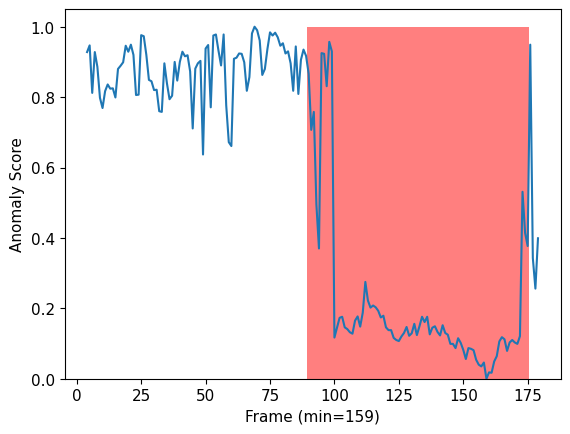

/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_wpsnr/UCSD Ped2/02/WPSNR_UCSD Ped2_02.jpg
save ok!


In [23]:
# 플로팅
plt.plot([num for num in range(length) if num>3],[norm_psnr for norm_psnr in norm_psnr_list])

# 최솟값 표시
plt.bar(anomaly_frame, 1, width=1, color='r',alpha=0.5)

# 라벨
plt.xlabel(f'Frame (min={str(idx_min+4)})')
plt.ylabel('Anomaly Score')

# 저장
save_path1_2 = os.path.join(save_dir1, f'WPSNR_{_detail}.jpg')
plt.savefig(save_path1_2)
plt.show()
print(save_path1_2)
print('save ok!')

이미지 저장  
* wpsnr이 가장 낮은 target, 두 번째로 낮은 target 객체는 박스 표시함
* target들보다 frame이 더 wpsnr 값이 낮으면 박스 표시 없음
* 박스가 한 개만 있는 이미지는 가장 낮은 wpsnr 혹은 두 번째로 낮은 wpsnr이 frame임

In [24]:
save_dir2 = '/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_image/'
save_dir2 = os.path.join(save_dir2,detail)
print(save_dir2)
createDirectory(save_dir2)

/home/chojh21c/sunghyun/Anomaly_Detection/3D-Attention-based-Anomaly-Detection/save_image/UCSD Ped2/02/frames
directory ok!


/tmp/ipykernel_2547/3126692648.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(7,7))


save ok


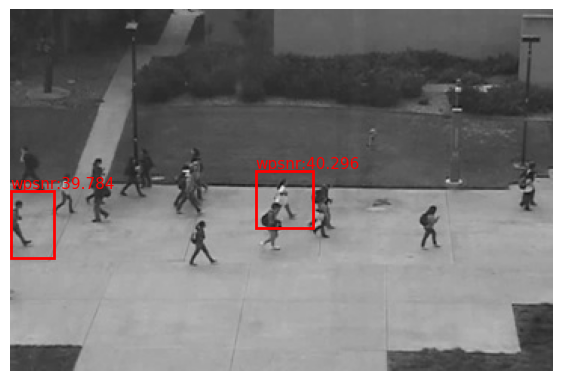

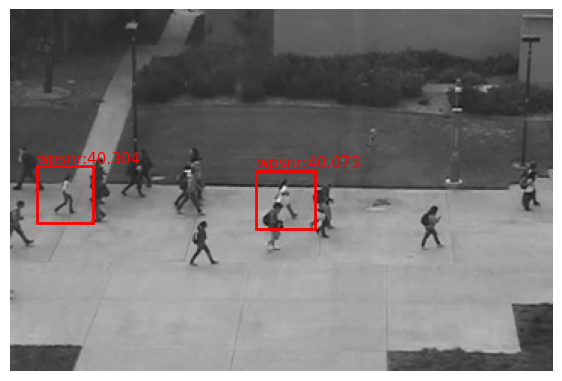

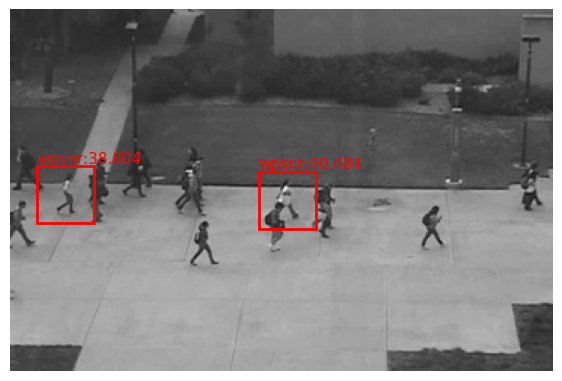

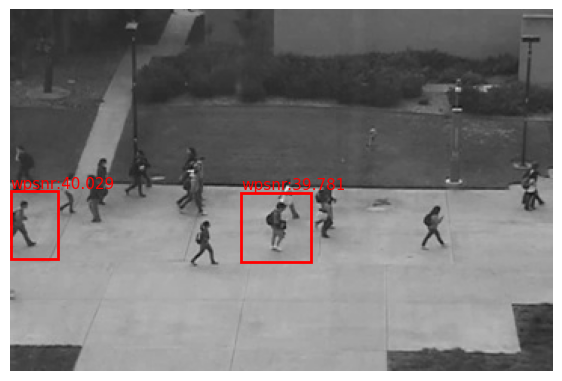

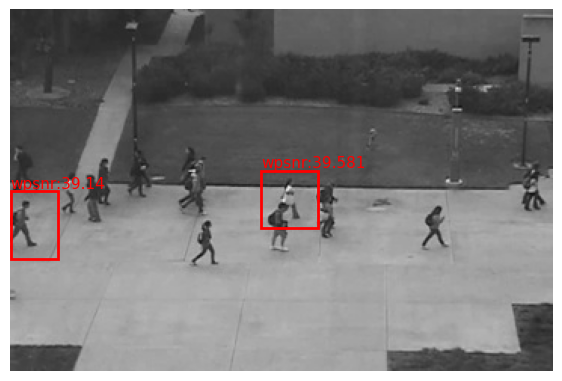

...

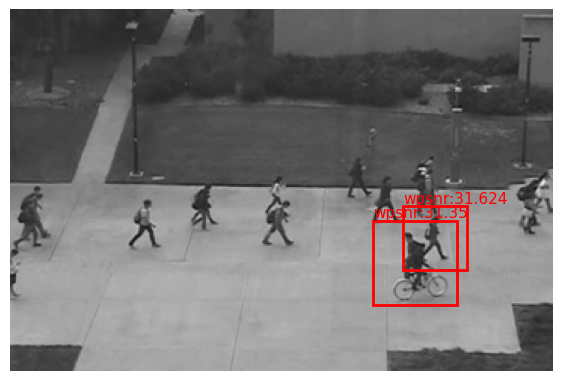

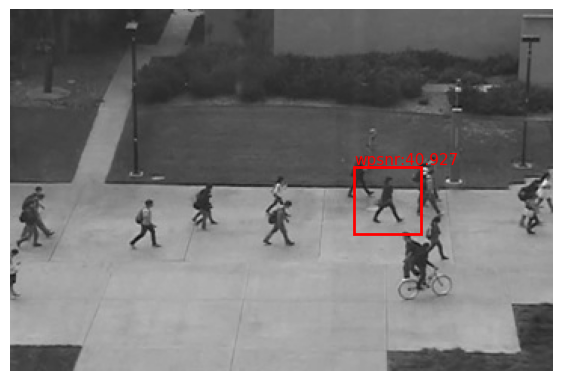

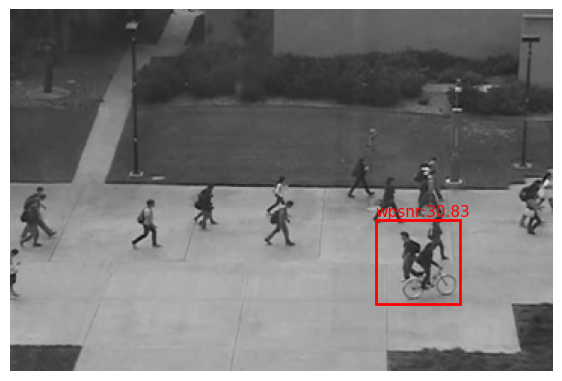

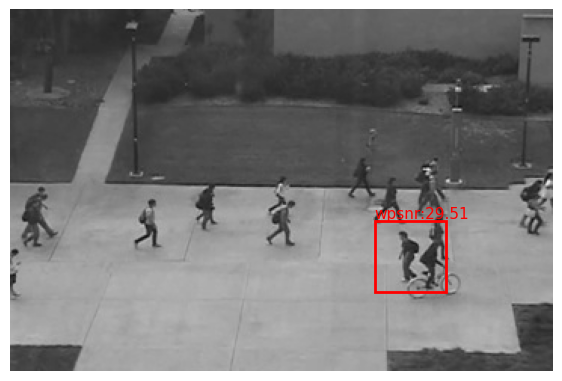

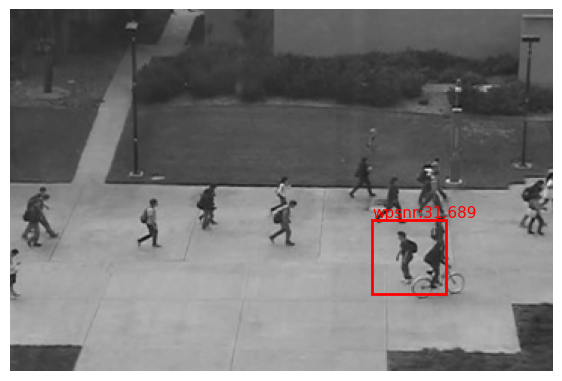

In [25]:
# load images
directory = os.path.join(path,detail)
images = glob.glob(directory+'/*.jpg')
images.sort()

# save images
for i in range(4, len(images)):
    image = plt.imread(images[i])
    plt.figure(figsize=(7,7))
    plt.imshow(image)
    plt.axis('off')

    areas = areas_list[i-4]
    
    for j, area in enumerate(areas):
        if area != [-1]:
            xmin = float(area[0])
            ymin = float(area[1])
            xmax = float(area[2])
            ymax = float(area[3])

            width = xmax - xmin
            height = ymax - ymin
            ax = plt.gca()
            rect = patches.Rectangle(
                    (xmin, ymin), width, height, linewidth=2, edgecolor='red', fill=False
                )
            ax.add_patch(rect)  
            if j==0:
                ax.text(xmin, ymin-2, f'wpsnr:{psnrs_list[i-4][0]}', color='r')
            else:
                ax.text(xmin, ymin-2, f'wpsnr:{psnrs_list[i-4][1]}', color='r')

    save_path2 = os.path.join(save_dir2, str(i)+'.jpg')
    plt.savefig(save_path2)
print('save ok')